## Sim Demo

### Imports

In [8]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [9]:
from env.imports import *

In [10]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

absolute_root_path /scratch/asr655/neuroinformatics/GeneEx2Conn


<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [11]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 3.2%
RAM Usage: 2.4%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [12]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [13]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [14]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

**Case Study 1: SMT CLS outperforms long range & geodesic (Random 8, Fold 2)**

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: g6qbobte
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/g6qbobte
Initialized sweep with ID: g6qbobte


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.5, 'epochs': 100}
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 0.0382
Best val loss so far at epoch 2: 0.0329
Best val loss so far at epoch 3: 0.0322
Best val loss so far at epoch 4: 0.0301
Best val loss so far at epoch 5: 0.0294
Epoch 5/100, Train Loss: 0.0654, Val Loss: 0.0294, Time: 6.47s
Best val loss so far at epoch 6: 0.0288
Best val loss so far at epoch 7: 0.0262
Best val loss so far at epoch 8: 0.0254
Best val loss so far at epoch 9: 0.0238
Best val loss so far at epoch 10: 0.0227
Epoch 10/100, Train Loss: 0.0447, Val Loss: 0.0227, Time: 5.59s
Best val los

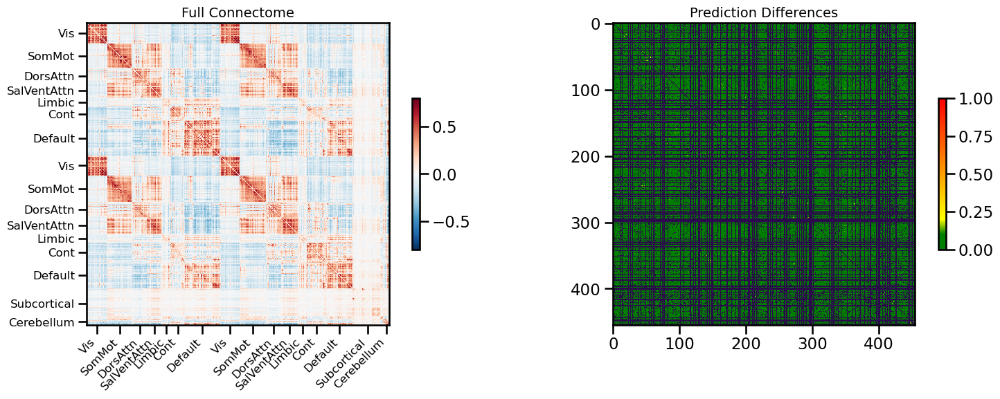

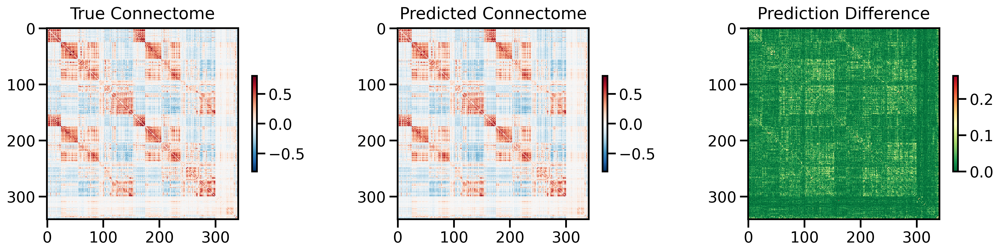

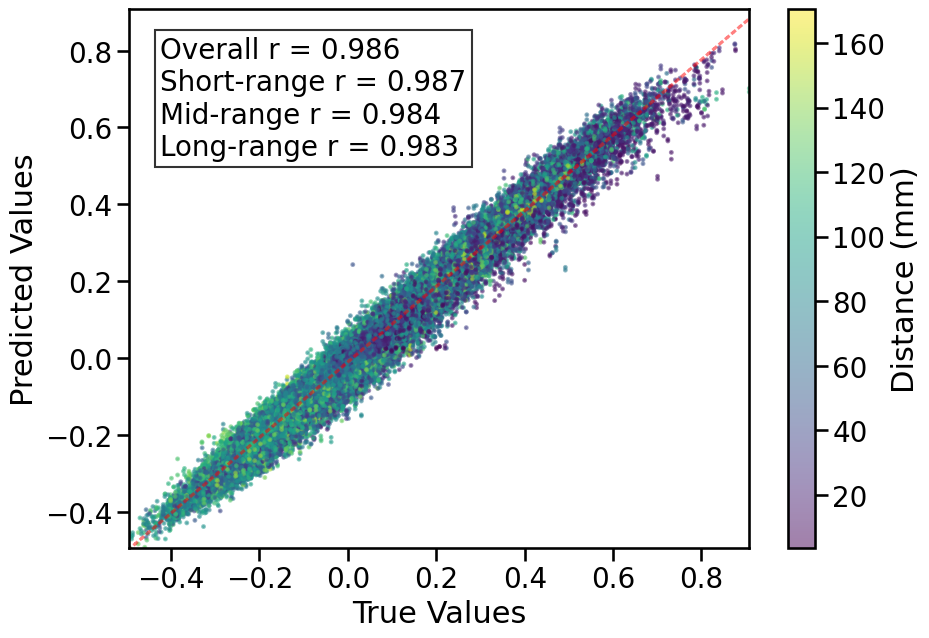

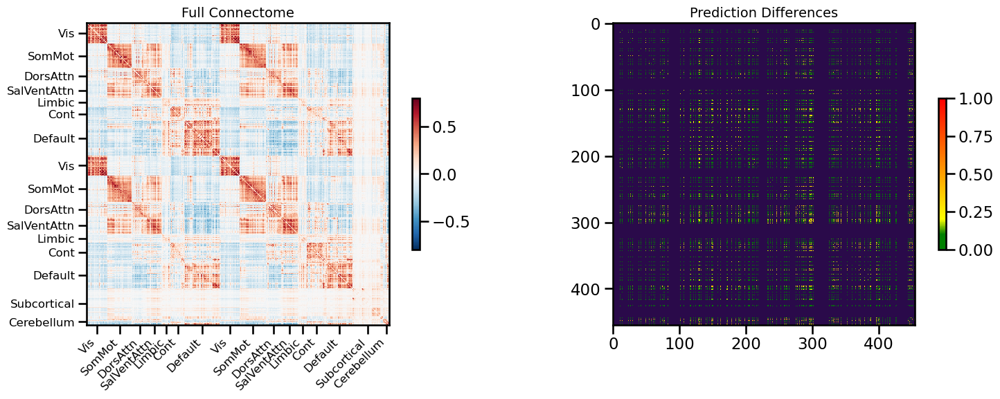

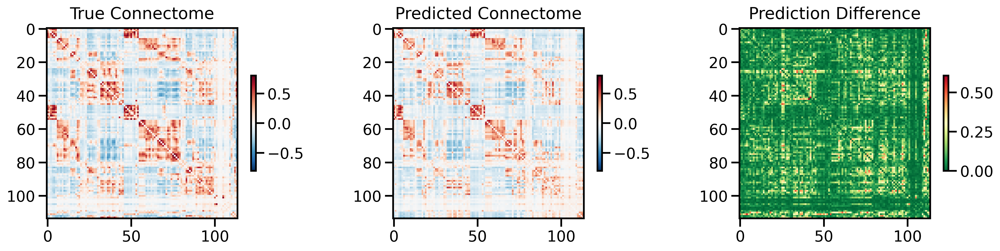

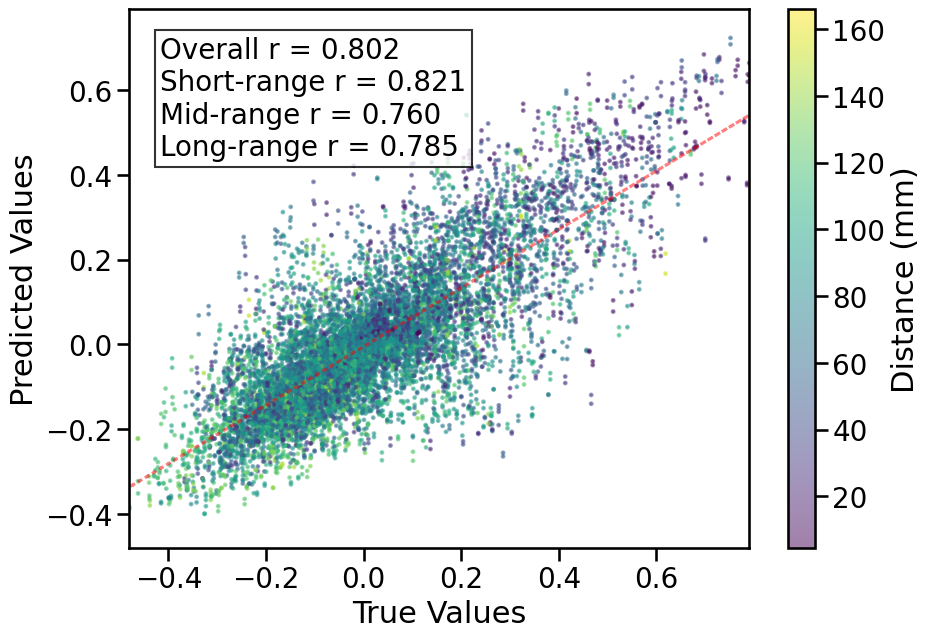


TRAIN METRICS: {'mse': 0.0010067022, 'mae': 0.023353582, 'r2': 0.9691289887397808, 'pearson_r': 0.9862146845401611, 'short_r': 0.9872764526659259, 'mid_r': 0.984433102558549, 'long_r': 0.9831066410047427, 'geodesic_distance': 15.25197695611306}
TEST METRICS: {'mse': 0.013085635, 'mae': 0.079354495, 'r2': 0.6386017270768252, 'pearson_r': 0.8021644899576319, 'short_r': 0.8212751691413719, 'mid_r': 0.7600230444397014, 'long_r': 0.7851027851862539, 'geodesic_distance': 9.198195000038059}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'cls_init': 'spatial_learned', 'use_alibi': True, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100, 'aug_prob': 0.5}
CPU Usage: 3.1%
RAM Usage: 5.2%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
----------------

44695

In [16]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=8,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True,
              null_model='none',
              use_folds=[2]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
features ['transcriptome', 'euclidean']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: x92uknv1
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/x92uknv1
Initialized sweep with ID: x92uknv1


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 14766, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 150}
Number of learnable parameters in MLP: 7726849
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.12 GB
Best val loss so far at epoch 1: 0.0320
Best val loss so far at epoch 2: 0.0284
Best val loss so far at epoch 3: 0.0266
Best val loss so far at epoch 4: 0.0245
Best val loss so far at epoch 5: 0.0230
Epoch 5/150, Train Loss: 0.0342, Val Loss: 0.0230, Time: 2.21s
Best val loss so far at epoch 6: 0.0222
Best val loss so far at epoch 7: 0.0199
Epoch 10/150, Train Loss: 0.0133, Val Loss: 0.0208, Time: 2.27s
Best val loss so far at epoch 11: 0.0163
Best val loss so far at epoch 13: 0.0157
Epoch 15/150, Train Loss: 0.0077, Val Loss: 0.0186, Time: 2.22s
Best val loss so far at epoch 16: 0.0151
Best val loss so far at epoch 18: 0.0150
Epoch 20/150, Train Loss: 0.0058, Val Loss: 0.020

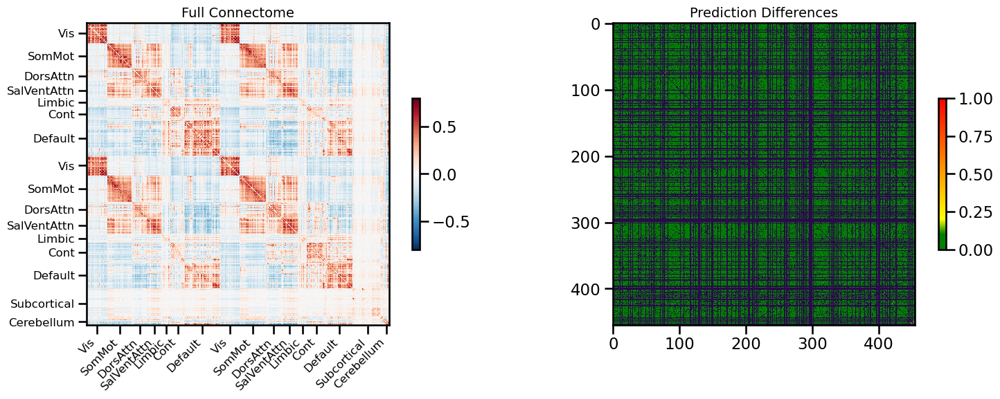

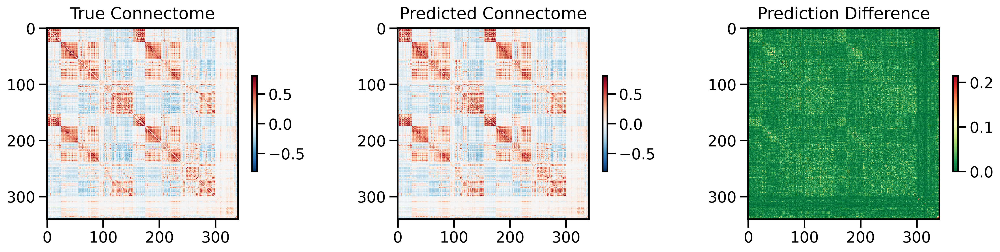

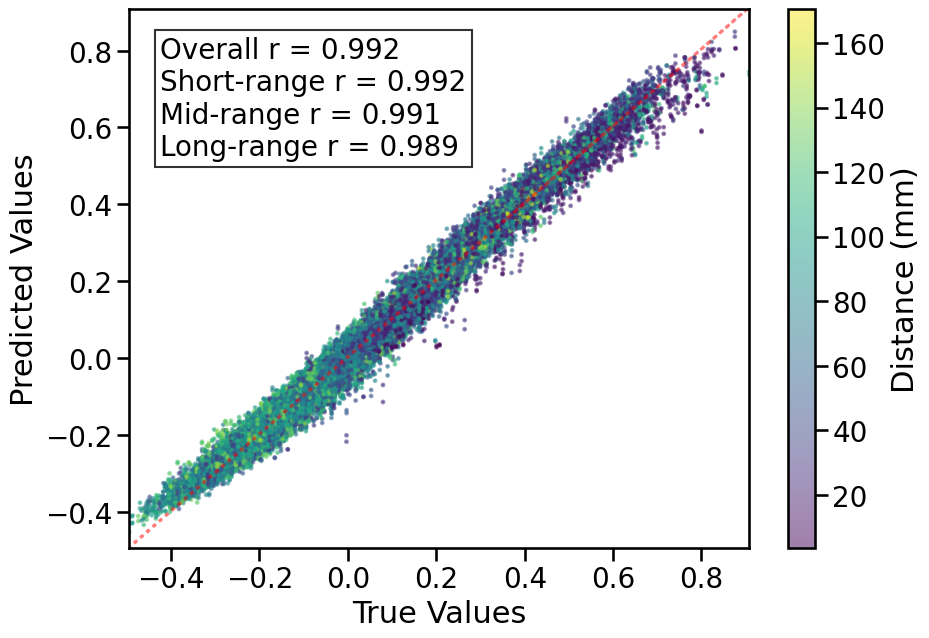

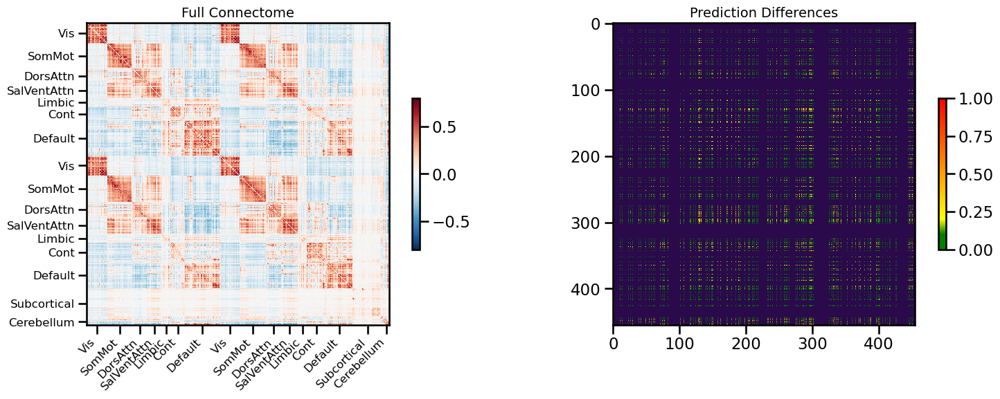

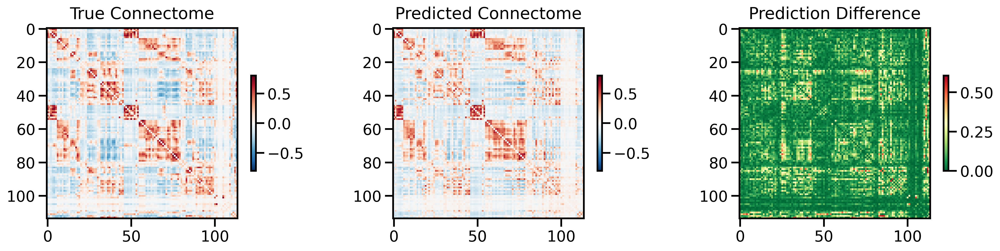

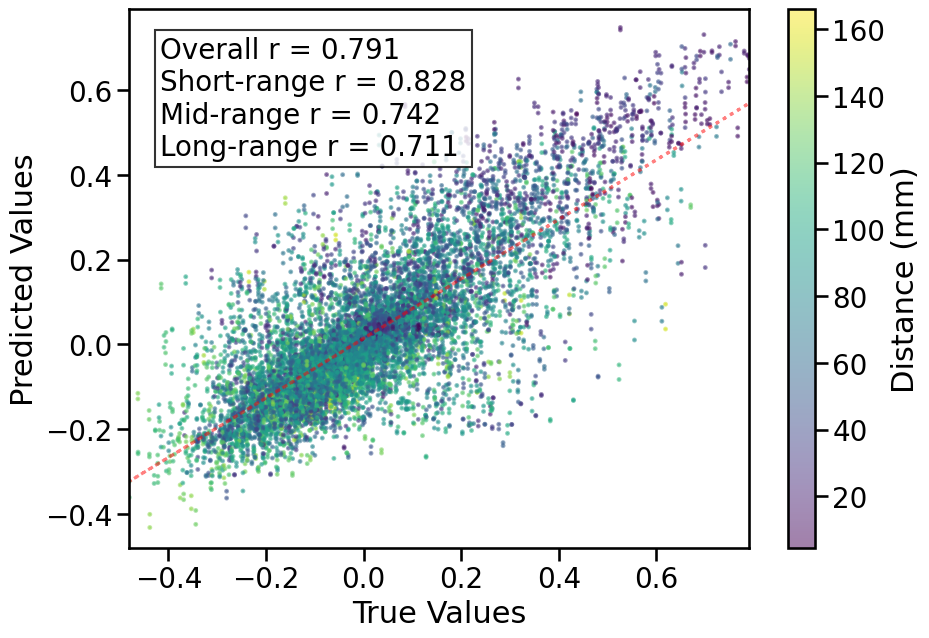


TRAIN METRICS: {'mse': 0.00054467685, 'mae': 0.017556887, 'r2': 0.9832972219980898, 'pearson_r': 0.9919217341239799, 'short_r': 0.9924536591678326, 'mid_r': 0.99093727143638, 'long_r': 0.9891548175982173, 'geodesic_distance': 13.459483688616139}
TEST METRICS: {'mse': 0.014025651, 'mae': 0.08082336, 'r2': 0.6126404322567685, 'pearson_r': 0.7910608446529445, 'short_r': 0.8279938252441535, 'mid_r': 0.741960459514498, 'long_r': 0.7111559699002288, 'geodesic_distance': 9.666486994308126}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14766, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 150}
CPU Usage: 2.3%
RAM Usage: 6.1%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 377.09 seconds (6.28 minutes)


36676

In [21]:
single_sim_run(
              feature_type=[{'transcriptome': None}, 
                           {'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=8,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[2]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  euclidean
processing_type:  None
features ['euclidean']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 050f7pnh
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/050f7pnh
Initialized sweep with ID: 050f7pnh


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 6, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 150}
Number of learnable parameters in MLP: 169729
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0336
Best val loss so far at epoch 2: 0.0317
Best val loss so far at epoch 3: 0.0300
Best val loss so far at epoch 4: 0.0294
Best val loss so far at epoch 5: 0.0292
Epoch 5/150, Train Loss: 0.0414, Val Loss: 0.0292, Time: 0.93s
Best val loss so far at epoch 6: 0.0289
Best val loss so far at epoch 10: 0.0288
Epoch 10/150, Train Loss: 0.0266, Val Loss: 0.0288, Time: 0.93s
Best val loss so far at epoch 11: 0.0287
Best val loss so far at epoch 12: 0.0281
Best val loss so far at epoch 13: 0.0281
Best val loss so far at epoch 14: 0.0279
Best val loss so far at epoch 15: 0.0275
Epoch 15/150, Train Loss: 0.0244, Val Loss: 0.0275, Time: 0.93s
Best val los

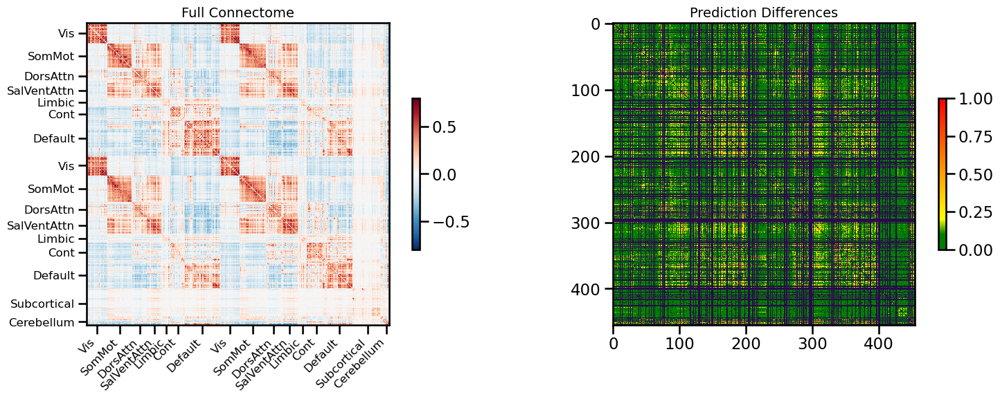

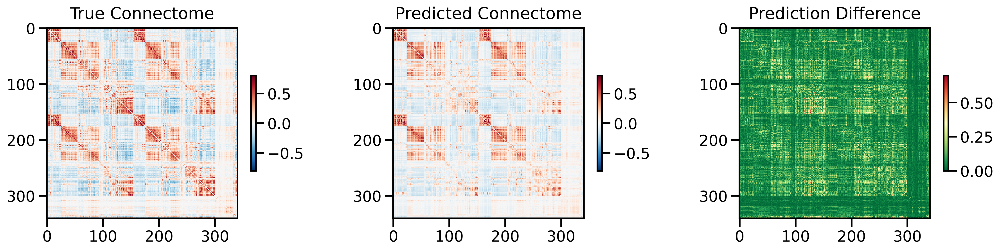

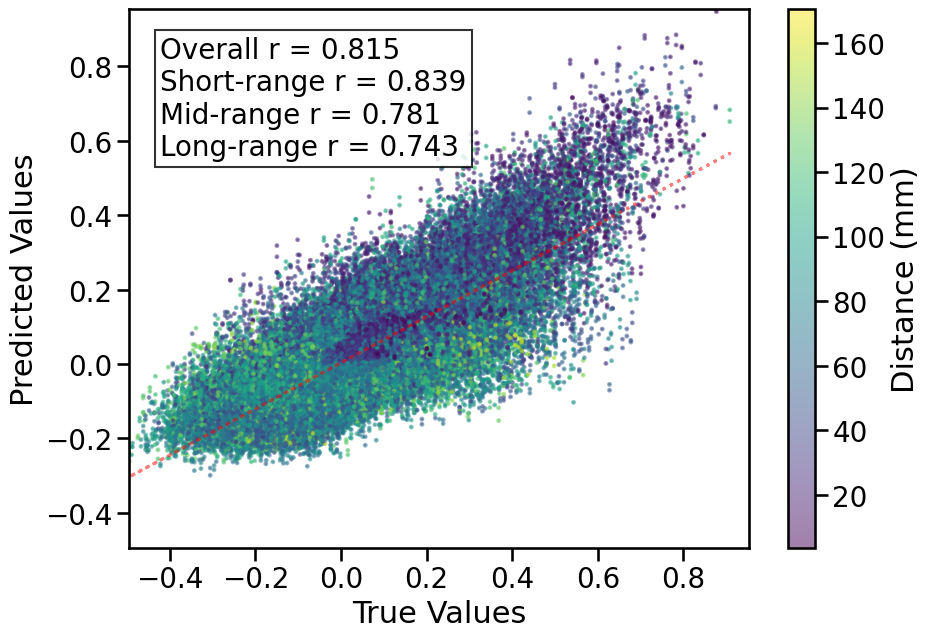

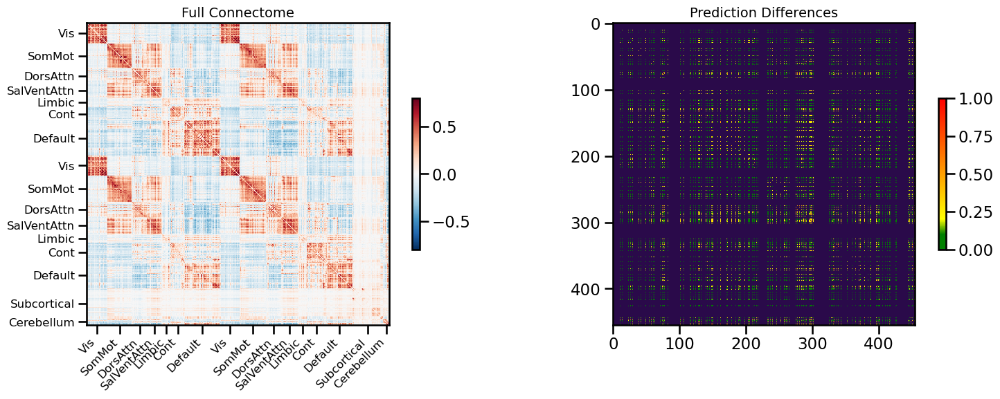

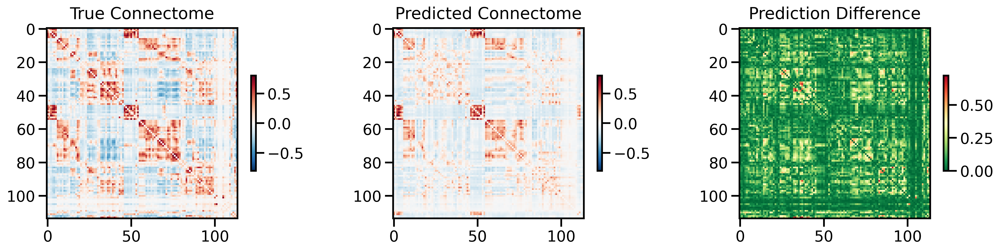

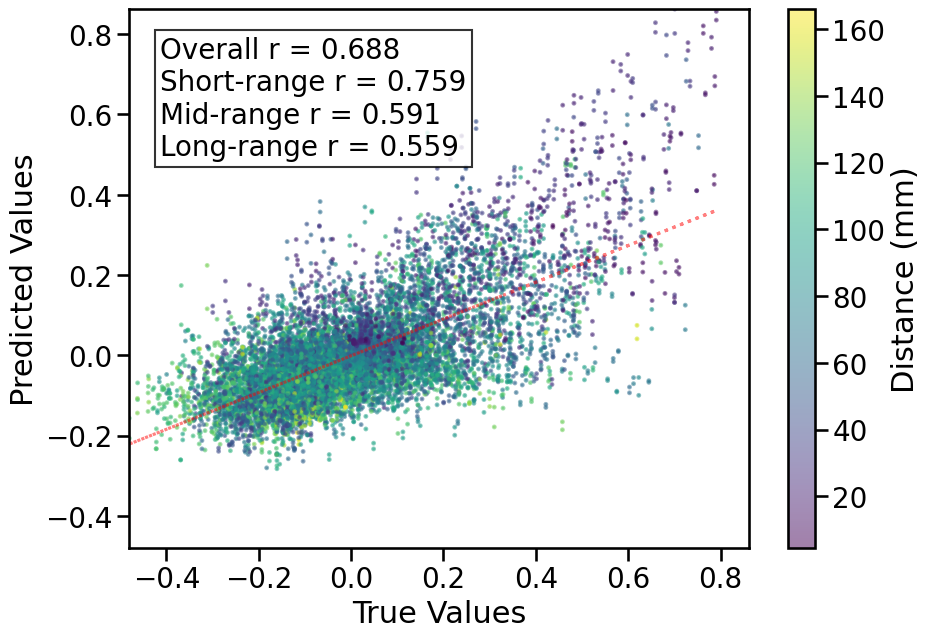


TRAIN METRICS: {'mse': 0.011062147, 'mae': 0.075485654, 'r2': 0.660773896428415, 'pearson_r': 0.8150807530655759, 'short_r': 0.8388375649231553, 'mid_r': 0.7807090937430866, 'long_r': 0.7434060377435869, 'geodesic_distance': 19.88532569957394}
TEST METRICS: {'mse': 0.019133452, 'mae': 0.09942973, 'r2': 0.4715734653921828, 'pearson_r': 0.6876083639529714, 'short_r': 0.7586741583443498, 'mid_r': 0.5909103551493209, 'long_r': 0.5594319856639584, 'geodesic_distance': 14.826017169265292}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 150}
CPU Usage: 1.8%
RAM Usage: 5.4%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 171.56 seconds (2.86 minutes)


36841

In [20]:
# Bump this to 3 layer
single_sim_run(
              feature_type=[{'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=8,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[2]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

**Case Study 2: SMT CLS outperforms long range (Random 3, Fold 2)**

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: f2ock3i7
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/f2ock3i7
Initialized sweep with ID: f2ock3i7


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.45, 'epochs': 100}
Number of learnable parameters in SMT w/ CLS model: 1405579
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.10 GB
Best val loss so far at epoch 1: 0.0458
Best val loss so far at epoch 2: 0.0369
Best val loss so far at epoch 3: 0.0353
Best val loss so far at epoch 4: 0.0338
Best val loss so far at epoch 5: 0.0326
Epoch 5/100, Train Loss: 0.0678, Val Loss: 0.0326, Time: 5.76s
Best val loss so far at epoch 6: 0.0309
Best val loss so far at epoch 7: 0.0294
Best val loss so far at epoch 8: 0.0293
Best val loss so far at epoch 9: 0.0260
Best val loss so far at epoch 10: 0.0248
Epoch 10/100, T

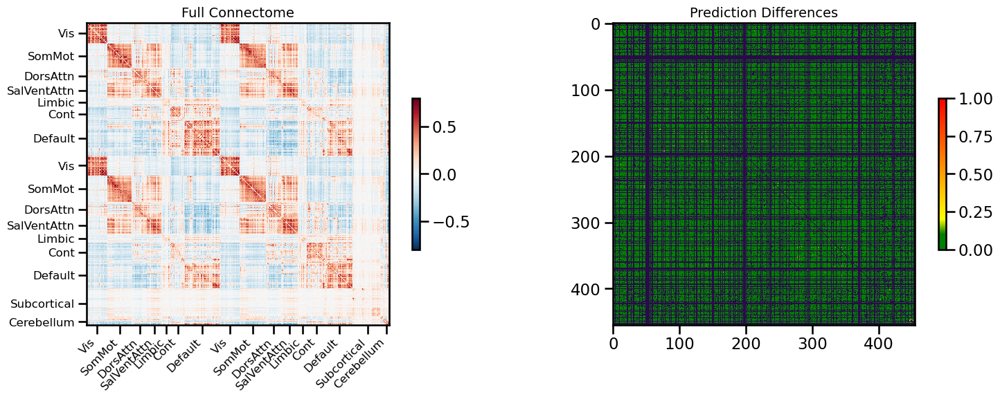

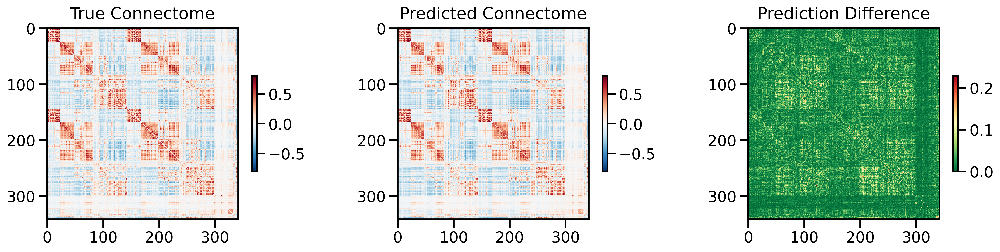

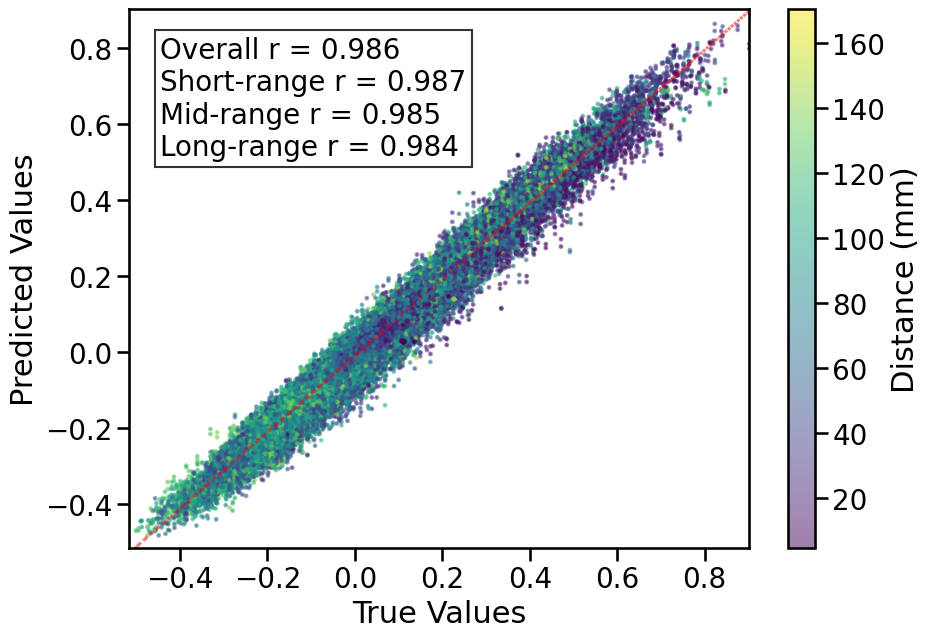

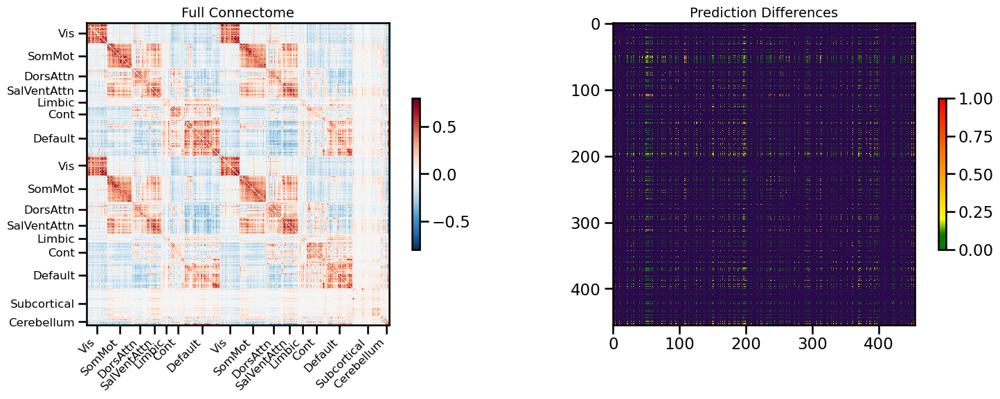

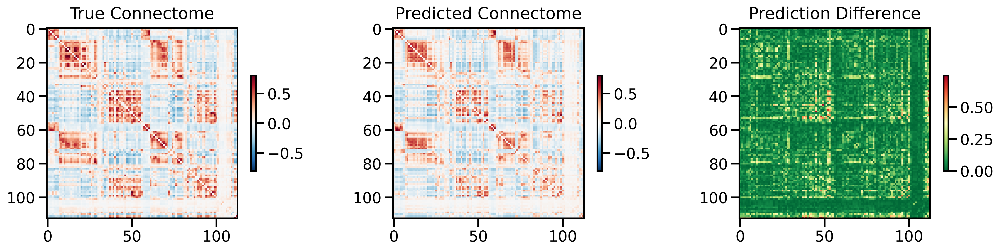

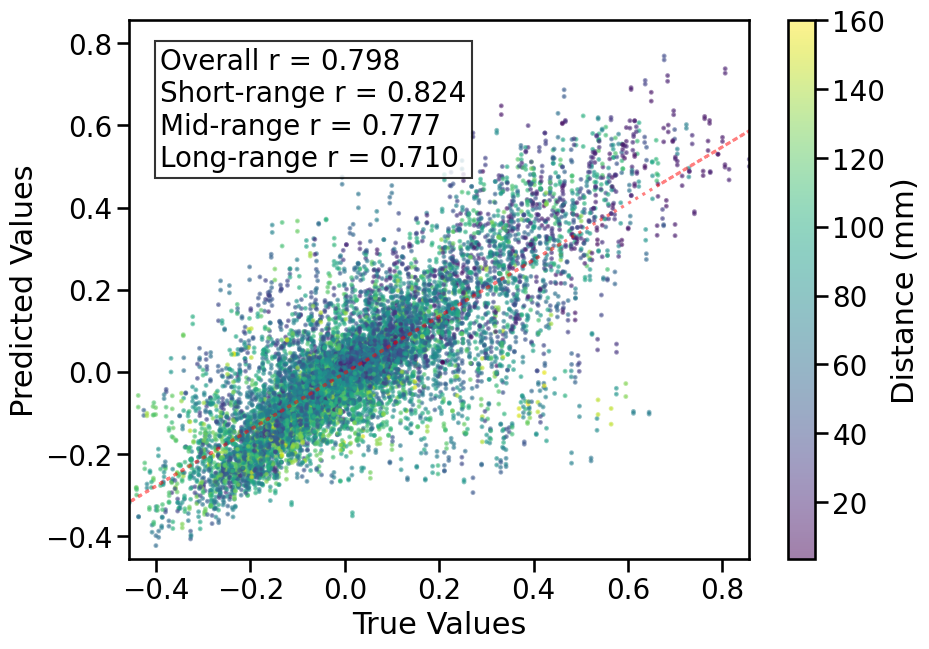


TRAIN METRICS: {'mse': 0.0009910342, 'mae': 0.02312443, 'r2': 0.968971430718451, 'pearson_r': 0.9864081695121543, 'short_r': 0.9871189598166272, 'mid_r': 0.9847820690828997, 'long_r': 0.9835014603467572, 'geodesic_distance': 13.87642558408558}
TEST METRICS: {'mse': 0.014551606, 'mae': 0.07963374, 'r2': 0.630325447075786, 'pearson_r': 0.7984913114448962, 'short_r': 0.8237050259750848, 'mid_r': 0.7769264993014398, 'long_r': 0.7096943379453529, 'geodesic_distance': 10.102295032088794}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'cls_init': 'spatial_learned', 'use_alibi': True, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100, 'aug_prob': 0.45}
CPU Usage: 2.2%
RAM Usage: 6.4%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
-----------------

44898

In [26]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=3,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True,
              null_model='none',
              use_folds=[2]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
features ['transcriptome', 'euclidean']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: aun0zzax
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/aun0zzax
Initialized sweep with ID: aun0zzax


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 14766, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 150}
Number of learnable parameters in MLP: 7726849
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.12 GB
Best val loss so far at epoch 1: 0.0346
Best val loss so far at epoch 2: 0.0307
Best val loss so far at epoch 3: 0.0288
Best val loss so far at epoch 4: 0.0270
Best val loss so far at epoch 5: 0.0257
Epoch 5/150, Train Loss: 0.0355, Val Loss: 0.0257, Time: 2.22s
Best val loss so far at epoch 6: 0.0239
Best val loss so far at epoch 8: 0.0211
Best val loss so far at epoch 10: 0.0211
Epoch 10/150, Train Loss: 0.0141, Val Loss: 0.0211, Time: 2.26s
Best val loss so far at epoch 11: 0.0202
Best val loss so far at epoch 12: 0.0164
Best val loss so far at epoch 14: 0.0155
Best val loss so far at epoch 15: 0.0146
Epoch 15/150, Train Loss: 0.0085, Val Loss: 0.0146, Time: 2.14s
Best val

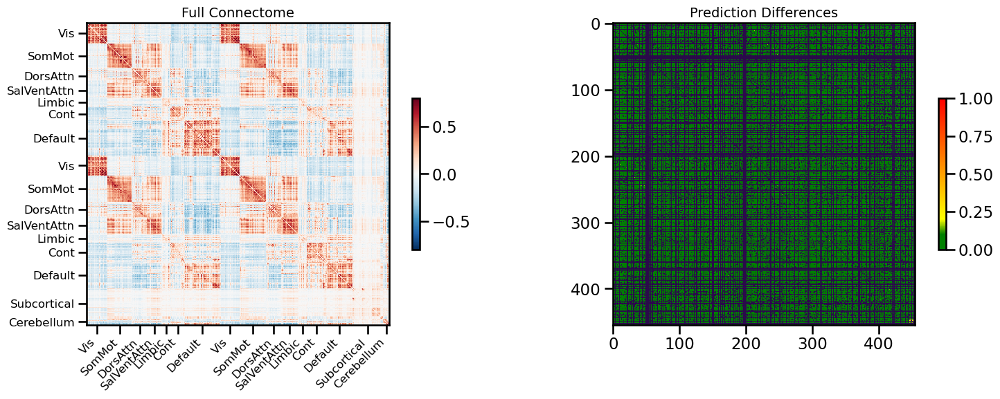

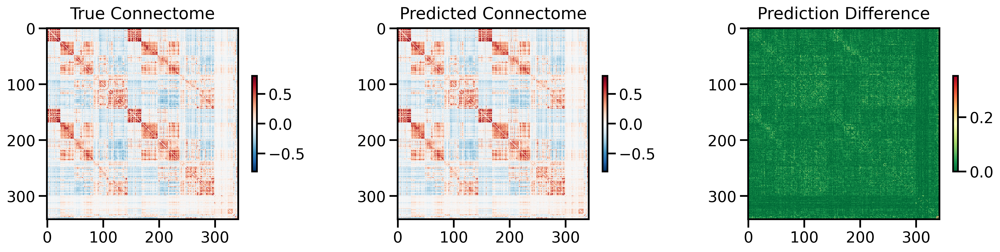

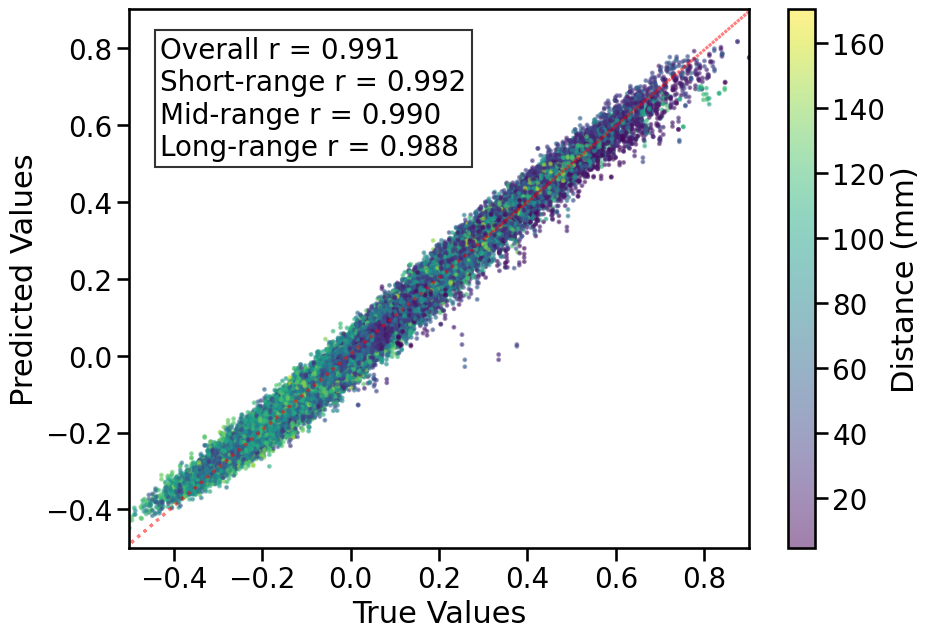

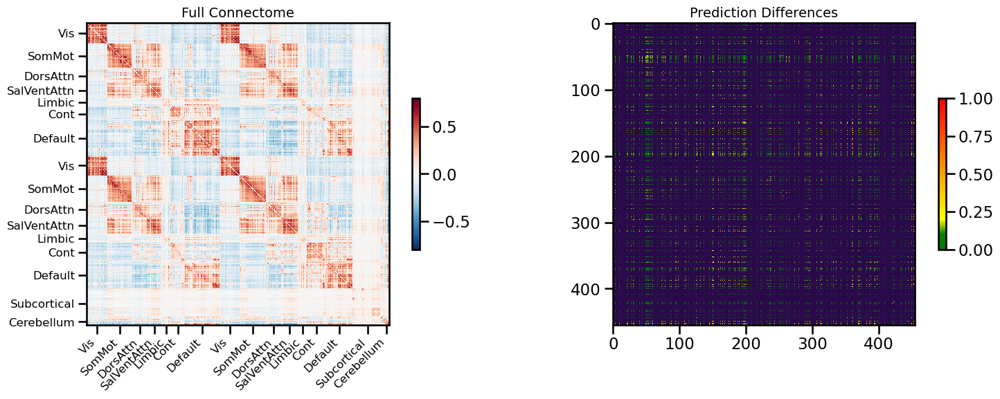

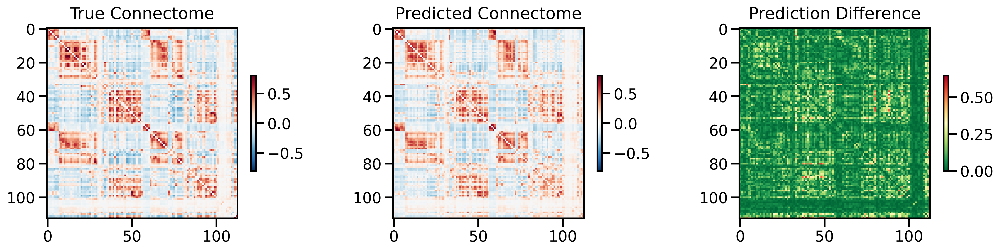

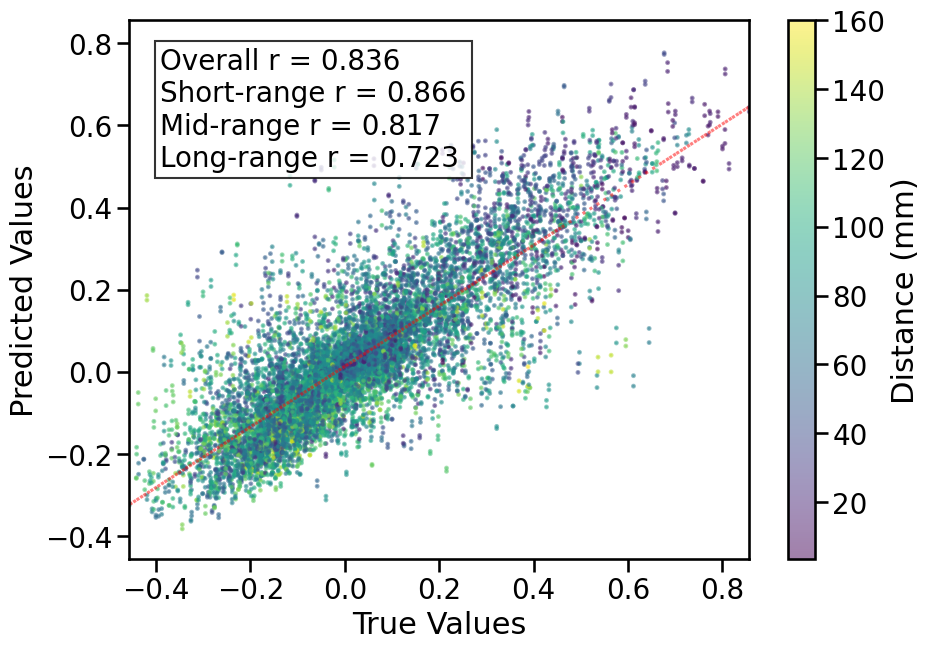


TRAIN METRICS: {'mse': 0.00057551503, 'mae': 0.018079588, 'r2': 0.9819810388806085, 'pearson_r': 0.9912524560436888, 'short_r': 0.9916736948115724, 'mid_r': 0.9902927599689354, 'long_r': 0.9876671765819945, 'geodesic_distance': 12.52814110919157}
TEST METRICS: {'mse': 0.01196691, 'mae': 0.07452628, 'r2': 0.6959880403301363, 'pearson_r': 0.8361794010144769, 'short_r': 0.8663232616945621, 'mid_r': 0.816797100013975, 'long_r': 0.7231244477396671, 'geodesic_distance': 9.724247866393577}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14766, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 150}
CPU Usage: 2.2%
RAM Usage: 6.2%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 387.56 seconds (6.46 minutes)


36850

In [23]:
single_sim_run(
              feature_type=[{'transcriptome': None}, 
                           {'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=3,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[2]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  euclidean
processing_type:  None
features ['euclidean']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 0fzqdr96
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/0fzqdr96
Initialized sweep with ID: 0fzqdr96


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 6, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 150}
Number of learnable parameters in MLP: 169729
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0375
Best val loss so far at epoch 2: 0.0340
Best val loss so far at epoch 3: 0.0327
Best val loss so far at epoch 4: 0.0321
Best val loss so far at epoch 5: 0.0320
Epoch 5/150, Train Loss: 0.0363, Val Loss: 0.0320, Time: 0.95s
Best val loss so far at epoch 6: 0.0319
Best val loss so far at epoch 7: 0.0319
Best val loss so far at epoch 8: 0.0317
Best val loss so far at epoch 9: 0.0314
Best val loss so far at epoch 10: 0.0313
Epoch 10/150, Train Loss: 0.0255, Val Loss: 0.0313, Time: 0.95s
Best val loss so far at epoch 11: 0.0309
Best val loss so far at epoch 12: 0.0306
Best val loss so far at epoch 13: 0.0304
Best val loss so far at epoch 14: 0.02

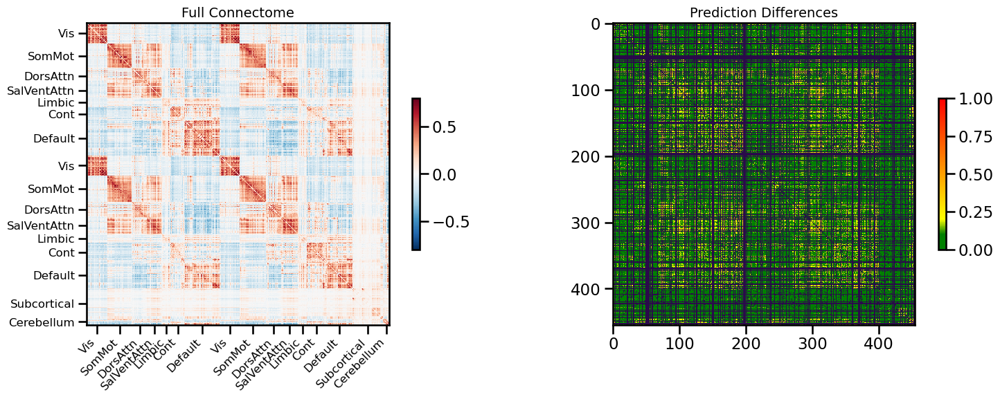

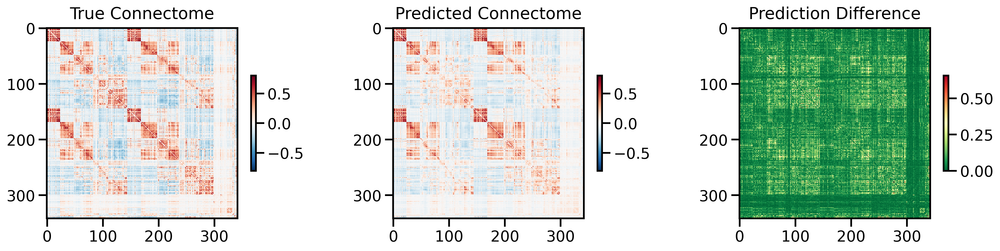

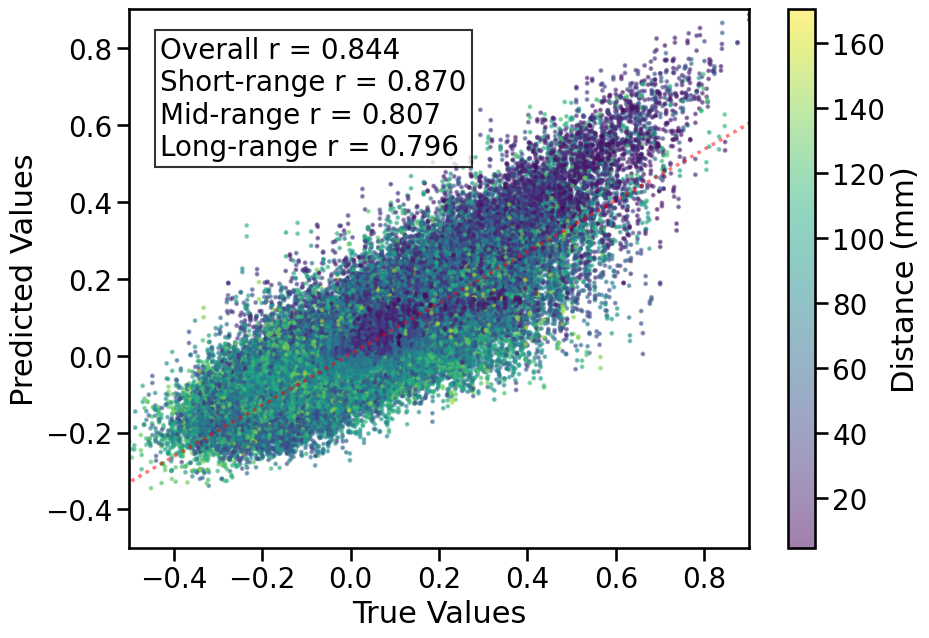

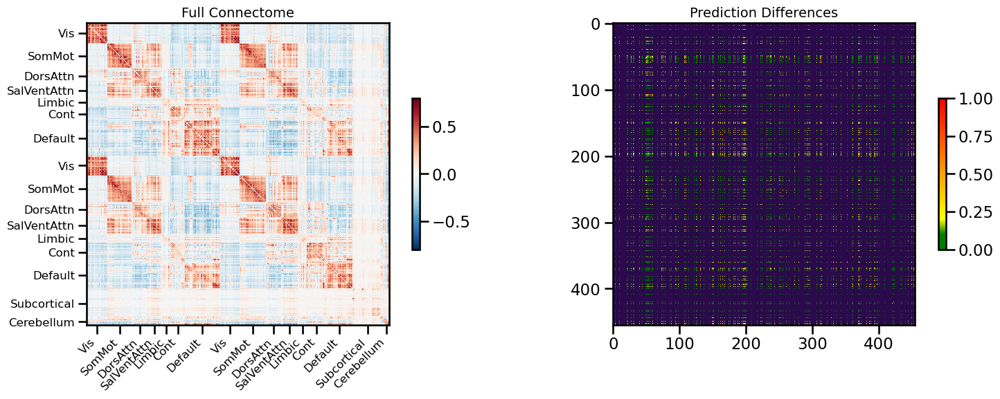

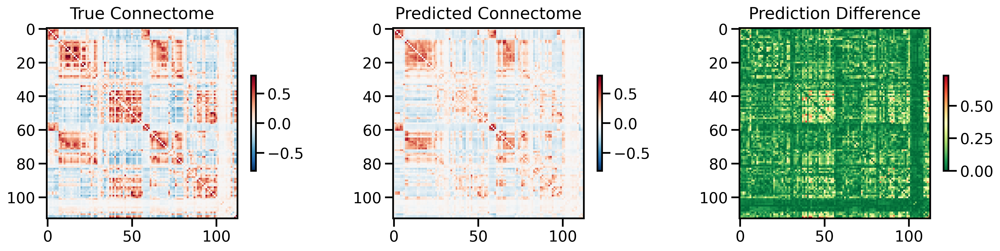

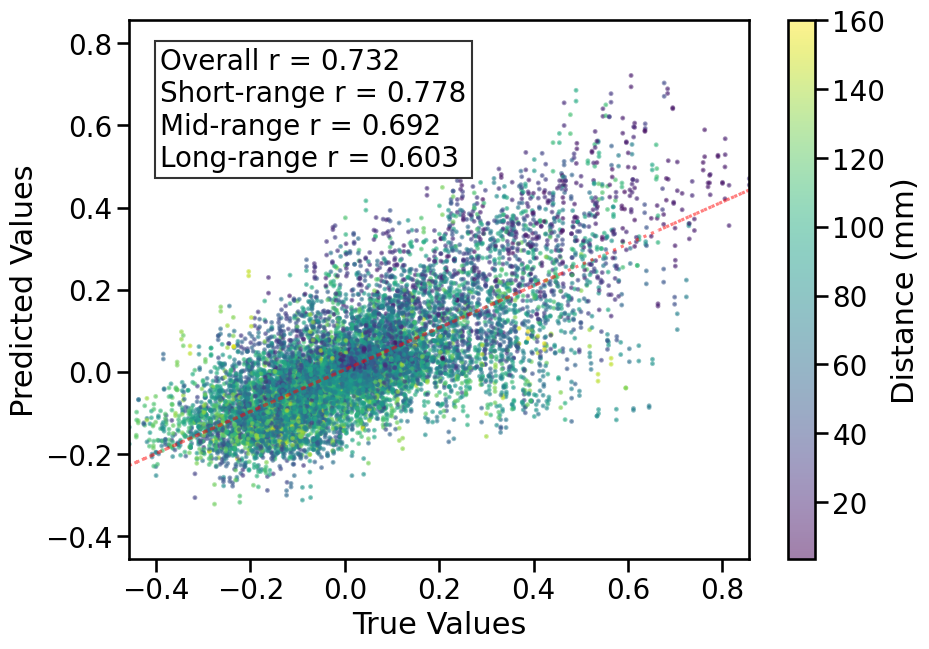


TRAIN METRICS: {'mse': 0.009276371, 'mae': 0.069529705, 'r2': 0.7095634985170302, 'pearson_r': 0.8441973526712199, 'short_r': 0.8696939219119028, 'mid_r': 0.80728825326648, 'long_r': 0.7959625770457853, 'geodesic_distance': 19.794365498969565}
TEST METRICS: {'mse': 0.018353375, 'mae': 0.09734646, 'r2': 0.5337439188843457, 'pearson_r': 0.7323784892188954, 'short_r': 0.777813906952292, 'mid_r': 0.691979094676192, 'long_r': 0.6033481277432293, 'geodesic_distance': 11.045077069436758}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 150}
CPU Usage: 3.3%
RAM Usage: 5.6%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 172.59 seconds (2.88 minutes)


36844

In [24]:
single_sim_run(
              feature_type=[{'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=3,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[2]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

**Case Study 3: SMT CLS outperforms long range (Random 2, Fold 3 or 42 fold 2)**

In [ ]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=2,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True,
              null_model='none',
              use_folds=[3]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

In [ ]:
single_sim_run(
              feature_type=[{'transcriptome': None}, 
                           {'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=2,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[3]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

In [ ]:
single_sim_run(
              feature_type=[{'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=2,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[3]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

**Case Study 4: Easy to predict all 3 models (Random 9, Fold 3)**

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: jxdmi9uh
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/jxdmi9uh
Initialized sweep with ID: jxdmi9uh
1
2
3
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.5, 'epochs': 100}


  warnings.warn(



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.01 GB


  warnings.warn(



Best val loss so far at epoch 1: 0.0377
Best val loss so far at epoch 2: 0.0291
Best val loss so far at epoch 3: 0.0233
Best val loss so far at epoch 4: 0.0207
Best val loss so far at epoch 5: 0.0197
Epoch 5/100, Train Loss: 0.0669, Val Loss: 0.0197, Time: 6.13s
Best val loss so far at epoch 6: 0.0188
Best val loss so far at epoch 7: 0.0179
Best val loss so far at epoch 8: 0.0172
Best val loss so far at epoch 9: 0.0170
Best val loss so far at epoch 10: 0.0160
Epoch 10/100, Train Loss: 0.0441, Val Loss: 0.0160, Time: 5.78s
Best val loss so far at epoch 11: 0.0153
Best val loss so far at epoch 12: 0.0152
Best val loss so far at epoch 13: 0.0145
Best val loss so far at epoch 15: 0.0138
Epoch 15/100, Train Loss: 0.0383, Val Loss: 0.0138, Time: 6.26s
Best val loss so far at epoch 16: 0.0136
Best val loss so far at epoch 17: 0.0135
Best val loss so far at epoch 18: 0.0131
Best val loss so far at epoch 20: 0.0121
Epoch 20/100, Train Loss: 0.0318, Val Loss: 0.0121, Time: 5.55s
Best val loss so

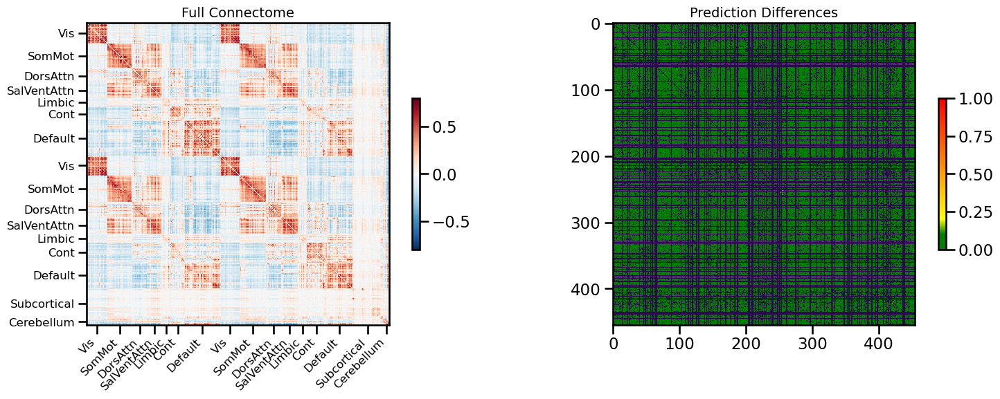

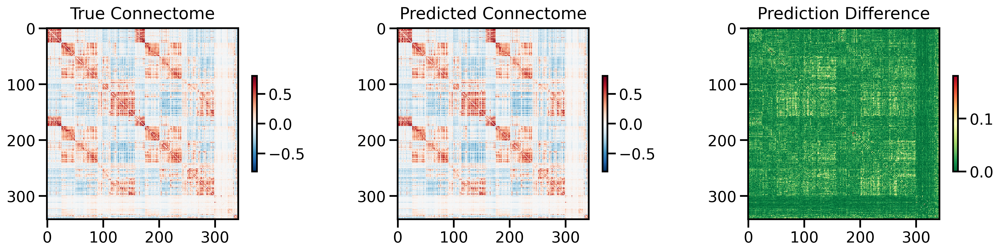

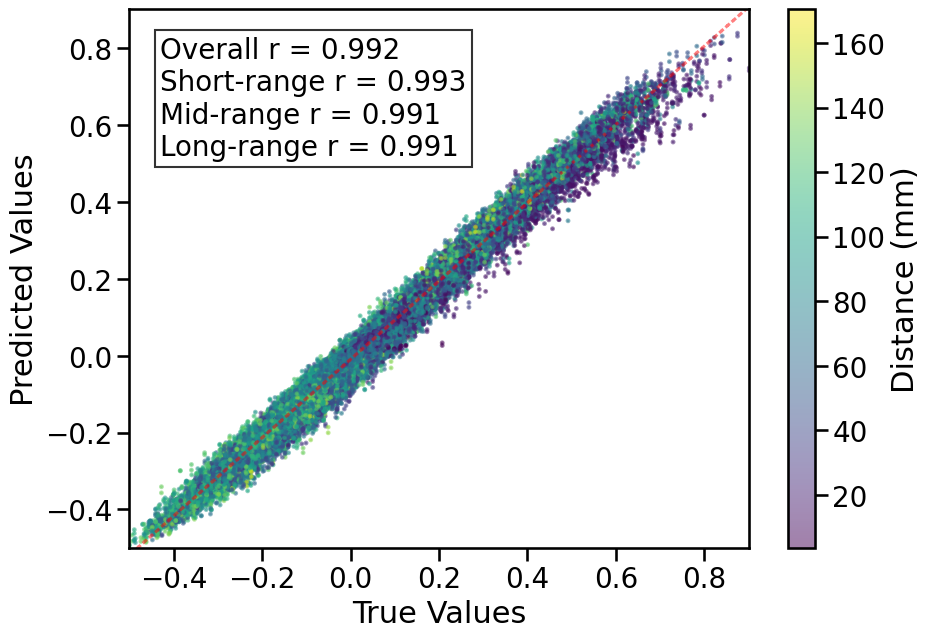

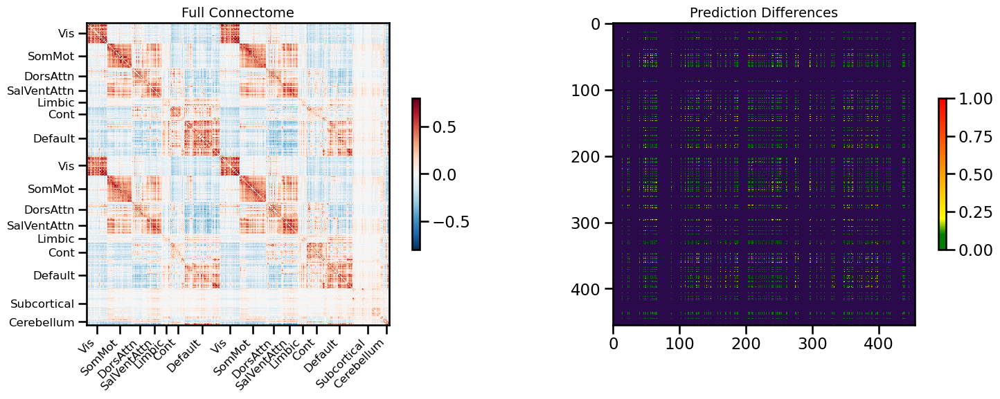

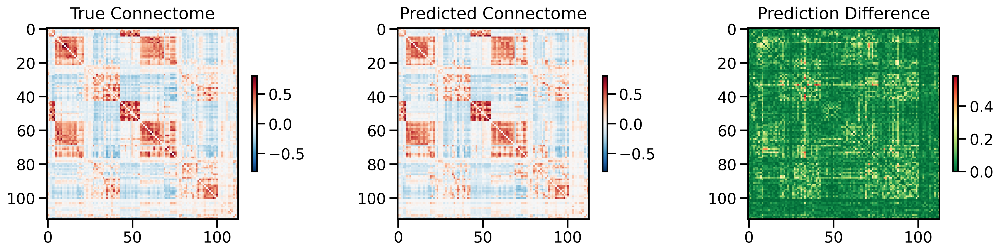

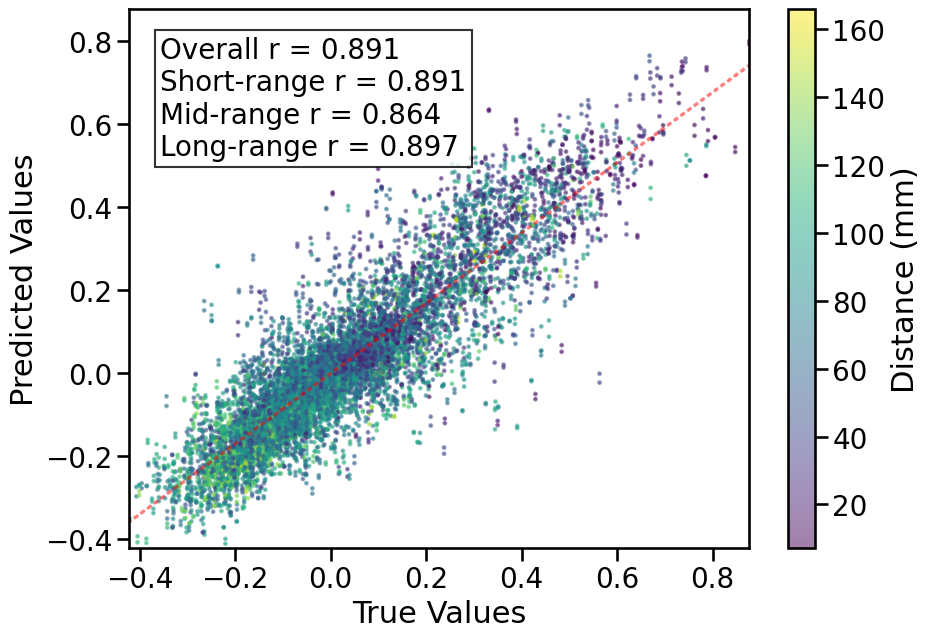


TRAIN METRICS: {'mse': 0.0006348137, 'mae': 0.018862503, 'r2': 0.9807147993677486, 'pearson_r': 0.9921528532472079, 'short_r': 0.9927079500674603, 'mid_r': 0.9913759894379475, 'long_r': 0.9909555836736299, 'geodesic_distance': 14.157700090431591}
TEST METRICS: {'mse': 0.0077112163, 'mae': 0.06138452, 'r2': 0.7892140475975362, 'pearson_r': 0.8907638063464344, 'short_r': 0.8907491292569701, 'mid_r': 0.8639087208186103, 'long_r': 0.8974797015090717, 'geodesic_distance': 8.718529236423803}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'use_alibi': True, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100, 'aug_prob': 0.5}
CPU Usage: 2.9%
RAM Usage: 5.0%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
---------

18107

In [15]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=9,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True, 
              null_model='none', 
              use_folds=[3]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
features ['transcriptome', 'euclidean']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: xp3544t7
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/xp3544t7
Initialized sweep with ID: xp3544t7


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 14766, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 150}
Number of learnable parameters in MLP: 7726849
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0304
Best val loss so far at epoch 2: 0.0271
Best val loss so far at epoch 3: 0.0239
Best val loss so far at epoch 4: 0.0209
Best val loss so far at epoch 5: 0.0190
Epoch 5/150, Train Loss: 0.0375, Val Loss: 0.0190, Time: 2.82s
Best val loss so far at epoch 6: 0.0166
Best val loss so far at epoch 7: 0.0147
Best val loss so far at epoch 8: 0.0136
Epoch 10/150, Train Loss: 0.0140, Val Loss: 0.0204, Time: 2.23s
Best val loss so far at epoch 11: 0.0128
Best val loss so far at epoch 12: 0.0124
Best val loss so far at epoch 14: 0.0116
Epoch 15/150, Train Loss: 0.0084, Val Loss: 0.0138, Time: 2.78s
Best val loss so far at epoch 16: 0.0101
Epoch 20/

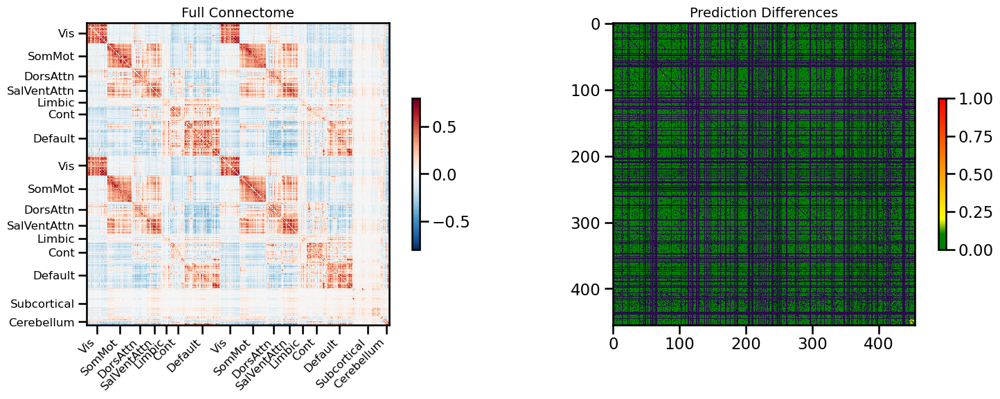

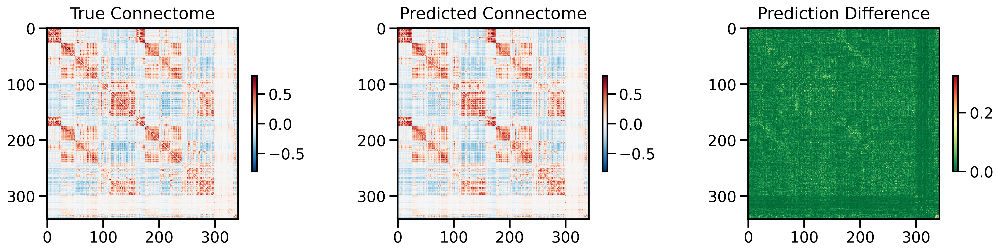

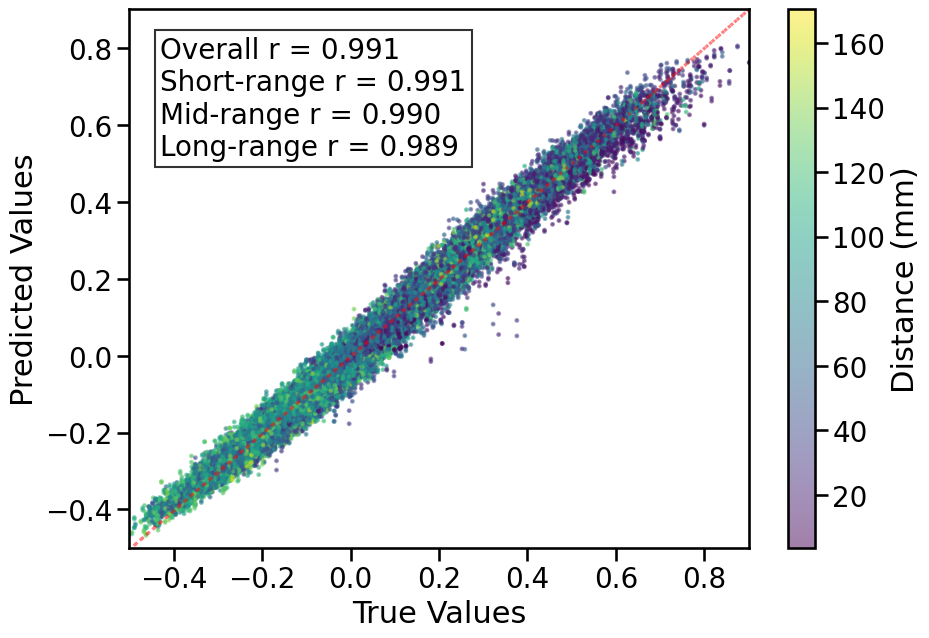

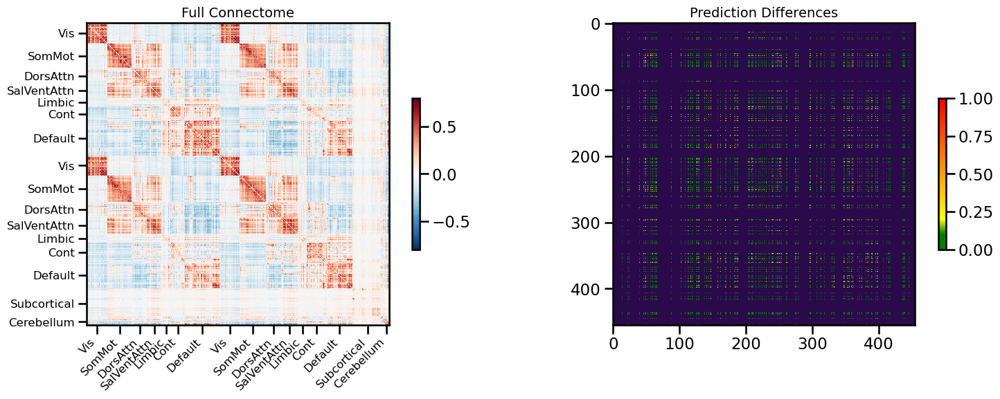

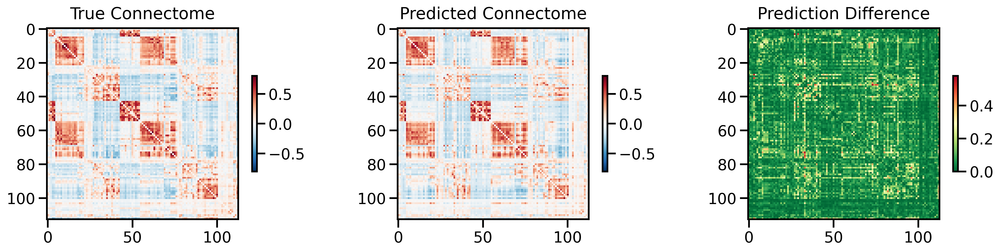

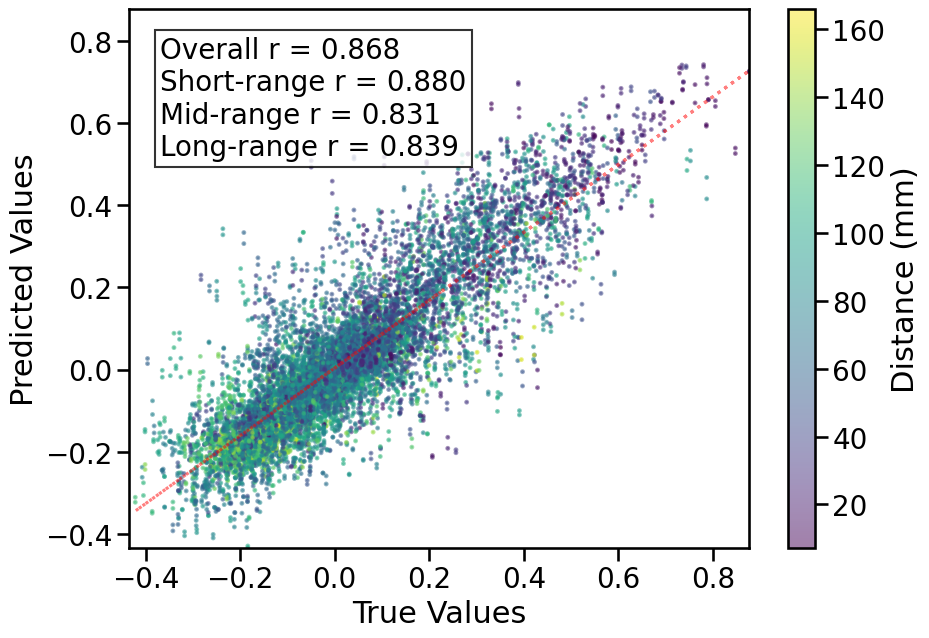


TRAIN METRICS: {'mse': 0.0006103537, 'mae': 0.018497612, 'r2': 0.9814578730322593, 'pearson_r': 0.991008286134063, 'short_r': 0.9912890071998186, 'mid_r': 0.9902195290430649, 'long_r': 0.9892601533571584, 'geodesic_distance': 15.014943187985073}
TEST METRICS: {'mse': 0.009270838, 'mae': 0.067215264, 'r2': 0.7465818378624884, 'pearson_r': 0.8679710647735378, 'short_r': 0.8802504916677946, 'mid_r': 0.8312633717693391, 'long_r': 0.8392268881695132, 'geodesic_distance': 8.975576978486416}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14766, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 150}
CPU Usage: 5.6%
RAM Usage: 4.0%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 375.55 seconds (6.26 minutes)


36881

In [16]:
single_sim_run(
              feature_type=[{'transcriptome': None}, 
                           {'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=9,
              search_method=('wandb', 'mse', 5),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='none', 
              use_folds=[3]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  euclidean
processing_type:  None
features ['euclidean']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: n0fj1q1g
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/n0fj1q1g
Initialized sweep with ID: n0fj1q1g


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 6, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 200}
Number of learnable parameters in MLP: 169729
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0291
Best val loss so far at epoch 2: 0.0256
Best val loss so far at epoch 3: 0.0246
Best val loss so far at epoch 4: 0.0238
Best val loss so far at epoch 5: 0.0234
Epoch 5/200, Train Loss: 0.0344, Val Loss: 0.0234, Time: 0.91s
Best val loss so far at epoch 6: 0.0233
Best val loss so far at epoch 8: 0.0230
Best val loss so far at epoch 9: 0.0227
Best val loss so far at epoch 10: 0.0224
Epoch 10/200, Train Loss: 0.0257, Val Loss: 0.0224, Time: 0.91s
Best val loss so far at epoch 11: 0.0222
Best val loss so far at epoch 12: 0.0218
Best val loss so far at epoch 13: 0.0216
Best val loss so far at epoch 14: 0.0211
Best val loss so far at epoch 15: 0.0

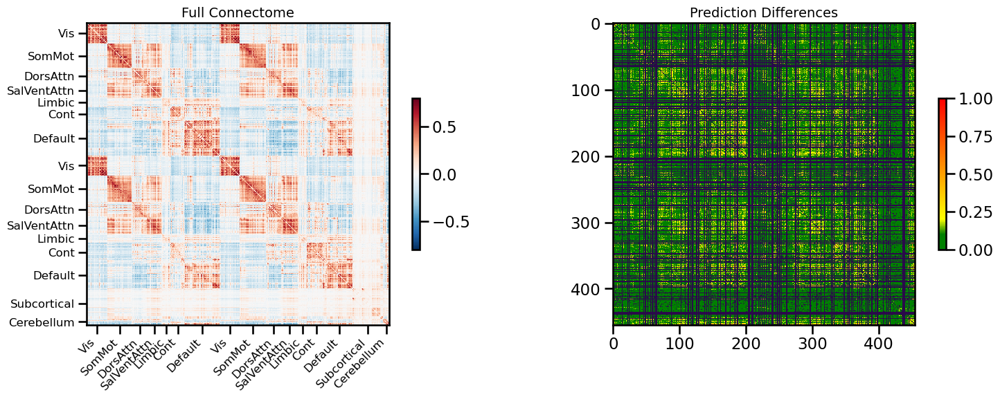

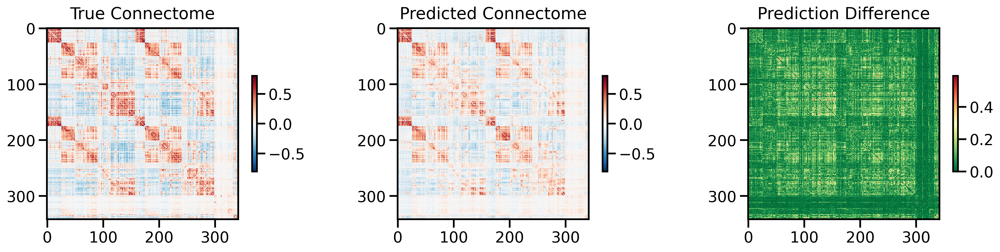

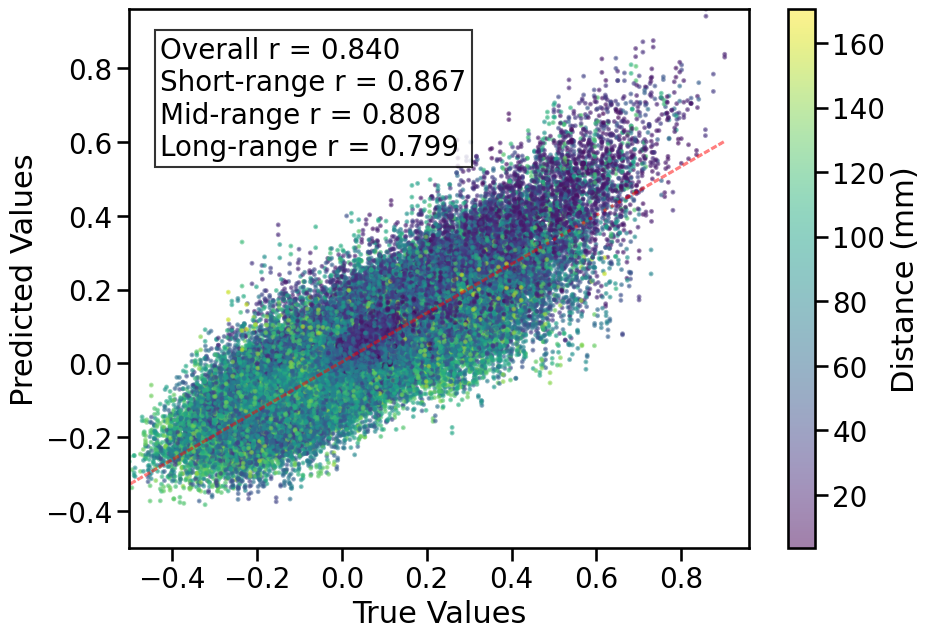

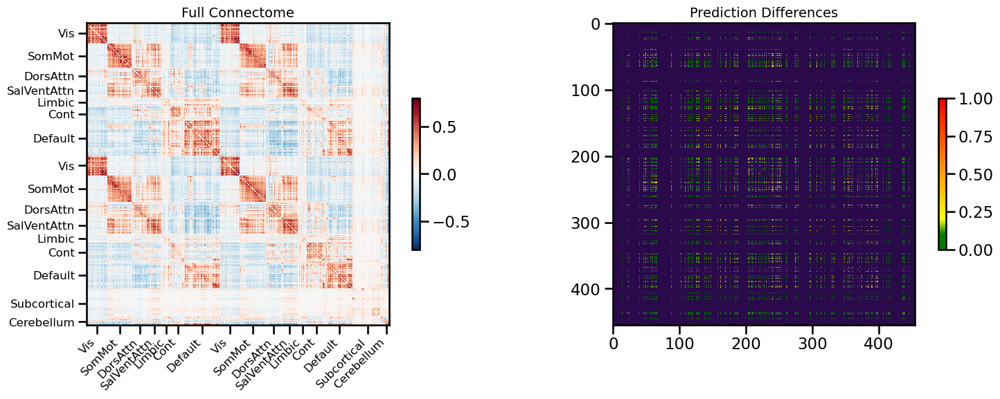

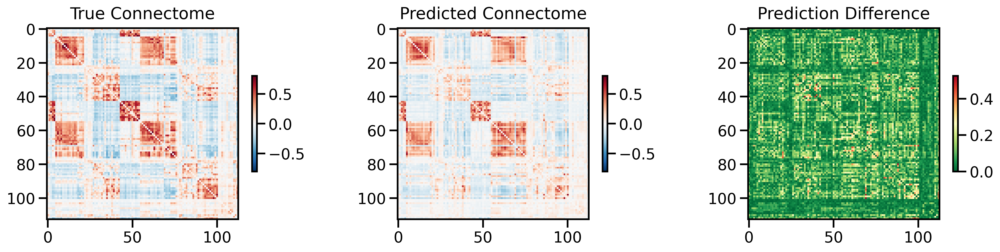

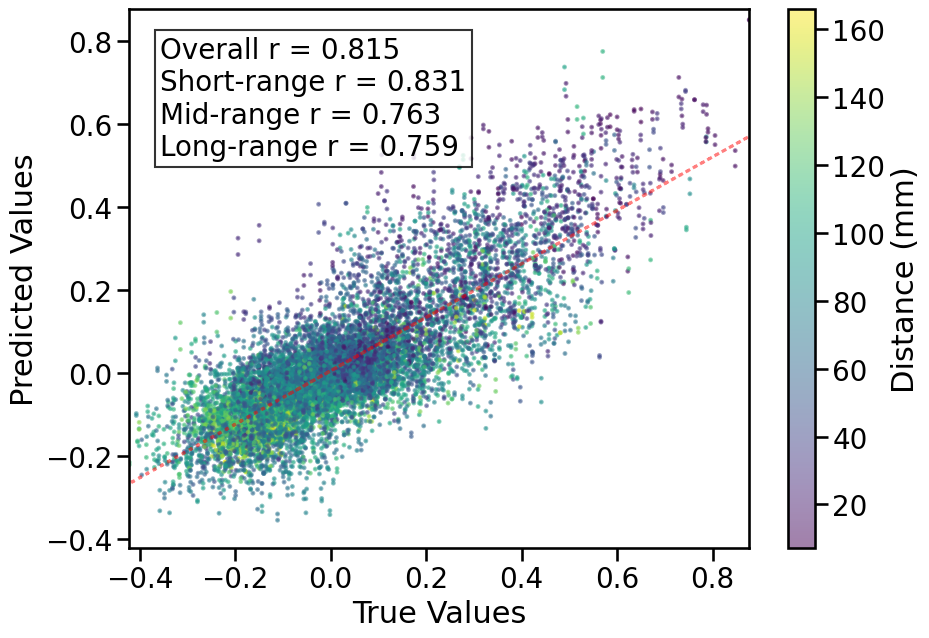


TRAIN METRICS: {'mse': 0.009773186, 'mae': 0.0717256, 'r2': 0.7030973474459116, 'pearson_r': 0.8400948441656778, 'short_r': 0.8669253321309192, 'mid_r': 0.8083976361576523, 'long_r': 0.7987508830489106, 'geodesic_distance': 20.717995412759144}
TEST METRICS: {'mse': 0.012289332, 'mae': 0.082737796, 'r2': 0.6640713879935312, 'pearson_r': 0.8154284867839732, 'short_r': 0.8305608714502895, 'mid_r': 0.7627396844711428, 'long_r': 0.7591547363598922, 'geodesic_distance': 12.077142038929274}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 200}
CPU Usage: 6.1%
RAM Usage: 3.1%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 232.69 seconds (3.88 minutes)


36887

In [14]:
single_sim_run(
              feature_type=[{'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=9,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='none', 
              use_folds=[3]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()